# Loan Analysis By DataNova

### (Matthew Ilori, Ambrose Ikpele & Priscilla Abimbola)



## Goal of Analysis

This case study aims analyse the status of applicants and their loan application in order to automate the process by building a machine learning model to predict the outcome of the lending process if the credit facility process was completed via e-process, that is E-Signed or not. Recognition of such applicants using Exploratory Data Analysis (EDA) techniques is the main focus of this case study.

In [ ]:
# Installing Pandas Profiling

!pip install pandas-profiling==3.3.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 268 kB 7.3 MB/s 
     |████████████████████████████████| 690 kB 54.4 MB/s 
     |████████████████████████████████| 4.7 MB 52.4 MB/s 
     |████████████████████████████████| 102 kB 55.3 MB/s 
     |████████████████████████████████| 9.8 MB 37.9 MB/s 
     |████████████████████████████████| 62 kB 1.4 MB/s 
     |████████████████████████████████| 296 kB 44.0 MB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=45622e22d6f074edab843a000d1db7c0f44906476cec30df415955ab5a746ad6
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14d250ba868768823940c3229e9950d201a26d0bd3ee8655
Successfully built htmlmin
  Attempting uninstall: statsmodels
    Found existing installation: statsmodels 0.12.2
    Uninstalling statsmodels-0.12.2:
      Successfully uninstalled statsmodels-0.12.2
  Attempting uninstall: requests
   

In [ ]:
# Importing the Libraries:

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Loading the Dataset:

train = pd.read_csv('train.csv')

### Taking a look at the data

In [ ]:
# Understanding the train dataframe:

train.head()

,Entry_id,age,pay_schedule,home_owner,income,months_employed,years_employed,current_address_year,personal_account_m,personal_account_y,...,amount_requested,risk_score,risk_score_2,risk_score_3,risk_score_4,risk_score_5,ext_quality_score,ext_quality_score_2,inquiries_last_month,e_signed
0,7629673,40,bi-weekly,1,3135,0,3,3,6,2,...,550,36200,0.737398,0.903517,0.487712,0.515977,0.580918,0.380918,10,1
1,5335819,33,semi-monthly,0,3590,0,5,2,2,8,...,1100,53850,0.617361,0.857560,0.613487,0.665523,0.744634,0.744634,12,0
2,8492423,21,weekly,0,2303,0,5,8,2,7,...,600,74850,0.677109,0.758765,0.495609,0.664762,0.592556,0.492556,6,1
3,7948313,26,bi-weekly,0,2795,0,4,4,1,6,...,800,50800,0.738055,0.873204,0.666437,0.700392,0.584130,0.684130,14,1
4,4297036,43,bi-weekly,0,5000,0,2,1,1,2,...,1100,69100,0.798303,0.841747,0.401971,0.568787,0.525905,0.725905,5,1


In [ ]:
train.describe()

,Entry_id,age,home_owner,income,months_employed,years_employed,current_address_year,personal_account_m,personal_account_y,has_debt,amount_requested,risk_score,risk_score_2,risk_score_3,risk_score_4,risk_score_5,ext_quality_score,ext_quality_score_2,inquiries_last_month,e_signed
count,1.251600e+04,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000,12516.000000
mean,5.599485e+06,43.026766,0.425056,3654.110658,1.191355,3.532998,3.593161,3.402205,3.508469,0.795462,950.251518,61133.401246,0.690665,0.877954,0.582848,0.718456,0.621944,0.621912,6.494088,0.540588
std,2.563354e+06,11.865891,0.494371,1508.072163,2.404529,2.265293,2.749211,2.206649,1.959969,0.403380,706.915146,15396.809340,0.090294,0.054197,0.125260,0.121103,0.139876,0.139623,3.731870,0.498370
min,1.111398e+06,18.000000,0.000000,905.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,350.000000,2100.000000,0.023258,0.451371,0.016724,0.153367,0.010184,0.006622,1.000000,0.000000
25%,3.376885e+06,34.000000,0.000000,2575.000000,0.000000,2.000000,2.000000,2.000000,2.000000,1.000000,600.000000,49450.000000,0.641221,0.850893,0.499887,0.635005,0.519794,0.519662,4.000000,0.000000
50%,5.608376e+06,42.000000,0.000000,3255.000000,0.000000,3.000000,3.000000,2.000000,3.000000,1.000000,700.000000,61200.000000,0.699621,0.880993,0.588202,0.725717,0.624081,0.623781,6.000000,1.000000
75%,7.803325e+06,51.000000,1.000000,4661.250000,1.000000,5.000000,5.000000,5.000000,4.000000,1.000000,1100.000000,72750.000000,0.752053,0.911485,0.672431,0.806576,0.729609,0.728389,8.000000,1.000000
max,9.999874e+06,96.000000,1.000000,9985.000000,11.000000,16.000000,12.000000,11.000000,14.000000,1.000000,10200.000000,99750.000000,0.999997,0.999012,0.978932,0.993363,0.970249,0.966953,30.000000,1.000000


In [ ]:
# Checking to see if  there are missing values in the train data:
# Looping  through the data to check for missing data

for col in train.columns:
    pct_missing = np.mean(train[col].isnull())
    print('{} - {}%'.format(col, round(pct_missing*100)))

Entry_id - 0%
age - 0%
pay_schedule - 0%
home_owner - 0%
income - 0%
months_employed - 0%
years_employed - 0%
current_address_year - 0%
personal_account_m - 0%
personal_account_y - 0%
has_debt - 0%
amount_requested - 0%
risk_score - 0%
risk_score_2 - 0%
risk_score_3 - 0%
risk_score_4 - 0%
risk_score_5 - 0%
ext_quality_score - 0%
ext_quality_score_2 - 0%
inquiries_last_month - 0%
e_signed - 0%


    From the result shown above, the train dataset is without any Null values.

In [ ]:
# Data Types for all columns in the train data:

print(train.dtypes)

Entry_id                  int64
age                       int64
pay_schedule             object
home_owner                int64
income                    int64
months_employed           int64
years_employed            int64
current_address_year      int64
personal_account_m        int64
personal_account_y        int64
has_debt                  int64
amount_requested          int64
risk_score                int64
risk_score_2            float64
risk_score_3            float64
risk_score_4            float64
risk_score_5            float64
ext_quality_score       float64
ext_quality_score_2     float64
inquiries_last_month      int64
e_signed                  int64
dtype: object


# EDA With pandas profiling

In [ ]:
from pandas_profiling import ProfileReport

In [ ]:
ProfileReport(train)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Adding new Columns and Groups

In [ ]:
# Changing the 1 and 0 values in the home_owner column to Landlord and Tenants in a new column:

train['home_own'] = train['home_owner'].replace([1, 0],['Landlord','Tenant'])

In [ ]:
# Changing the 1 and 0 values in the has_debt column to Owing and Not Owing in a new column:

train['debtors'] = train['has_debt'].replace([1, 0],['Has Debt','No Debt'])

In [ ]:
# Creating a age group for the loan applicants:

train.loc[train["age"] <= 19, "age_group"] = "teenager"
train.loc[train["age"].between (20, 39), "age_group"] = "young_adult"
train.loc[train["age"].between (40, 59), "age_group"] = "middle_adult"
train.loc[train["age"].between (60, 99), "age_group"] = "old_adult"

In [ ]:
train.head()

,Entry_id,age,pay_schedule,home_owner,income,months_employed,years_employed,current_address_year,personal_account_m,personal_account_y,...,risk_score_3,risk_score_4,risk_score_5,ext_quality_score,ext_quality_score_2,inquiries_last_month,e_signed,home_own,debtors,age_group
0,7629673,40,bi-weekly,1,3135,0,3,3,6,2,...,0.903517,0.487712,0.515977,0.580918,0.380918,10,1,Landlord,Has Debt,middle_adult
1,5335819,33,semi-monthly,0,3590,0,5,2,2,8,...,0.857560,0.613487,0.665523,0.744634,0.744634,12,0,Tenant,Has Debt,young_adult
2,8492423,21,weekly,0,2303,0,5,8,2,7,...,0.758765,0.495609,0.664762,0.592556,0.492556,6,1,Tenant,Has Debt,young_adult
3,7948313,26,bi-weekly,0,2795,0,4,4,1,6,...,0.873204,0.666437,0.700392,0.584130,0.684130,14,1,Tenant,Has Debt,young_adult
4,4297036,43,bi-weekly,0,5000,0,2,1,1,2,...,0.841747,0.401971,0.568787,0.525905,0.725905,5,1,Tenant,Has Debt,middle_adult


## Financial Analysis

In [ ]:
#checking for number of users that used e-signature

print(train.e_signed.value_counts())

1    6766
0    5750
Name: e_signed, dtype: int64


From the output above about 6766 loan applicants have completed their applications as an e-signing process while 5750 haven't

.

#### Taking a look at the Home_owners

In [ ]:
#checking for number of users that are home owners

train.home_own.value_counts()

Tenant      7196
Landlord    5320
Name: home_own, dtype: int64

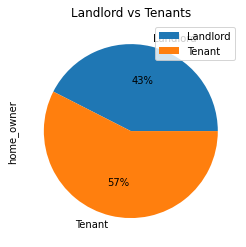

In [ ]:
# Plotting a pie chart that shows the distribution Landlords and the non-home owners among the loan applicants.

train.groupby(['home_own']).count().plot(kind='pie', y='home_owner',autopct='%1.0f%%', title='Landlord vs Tenants')

There are more tenants than Landlords(Home owners)

.

In [ ]:
#grouping home owners by e signature

train.groupby("e_signed")["home_own"].value_counts()

e_homeowner = train.groupby(["e_signed","home_own"]).size().to_frame()
e_homeowner

0
e_signed home_own      
0        Landlord  2613
         Tenant    3137
1        Landlord  2707
         Tenant    4059

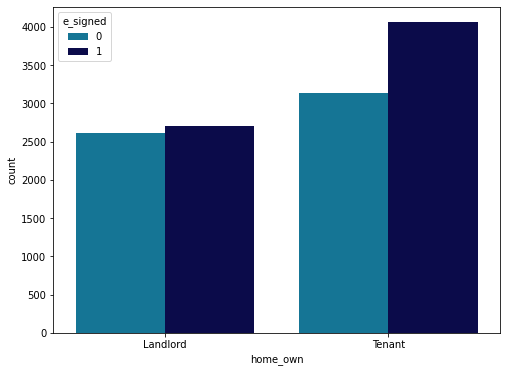

In [ ]:
#plotting the graph that shows home owners by e signature

plt.figure(figsize=(8,6))
sns.countplot(x="home_own", hue="e_signed", data=train, palette='ocean_r')

About 50.88% of the Landlords have completed the application process(e-signing) while the rest haven't. And about 56.41% of the Tenants have completed the e-signing application process while 43.59 haven't.

.

#### Taking a look at the Payment Schedule

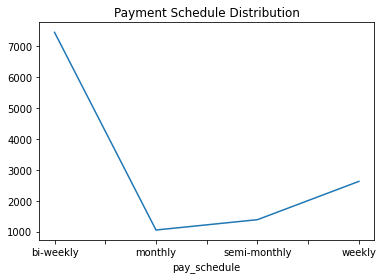

In [ ]:
# Looking at the distribution of the payment schedule across the loan applicants 

payment_schedule_freq = train.groupby('pay_schedule')['Entry_id'].count()

pay_schedule_freq_bar = payment_schedule_freq.plot(kind='line', title = 'Payment Schedule Distribution')

The Bi-weekly payment plan is the most used payment schedule among the applicants followed by the weekly payment plan.

In [ ]:
#grouping pay schedule by e signature

train.groupby("pay_schedule")["income"].mean()


pay_schedule
bi-weekly       3611.497381
monthly         3796.480076
semi-monthly    3900.539625
weekly          3587.586220
Name: income, dtype: float64

Averagely, the highest income earners use the semi-monthly payment schedule while the lowest use the weekly payment schedule.

In [ ]:
train.groupby(["pay_schedule", "e_signed"])["amount_requested"].mean()

pay_schedule  e_signed
bi-weekly     0            871.754315
              1            979.274742
monthly       0            868.288618
              1           1096.580071
semi-monthly  0            978.300000
              1           1132.714286
weekly        0            958.883389
              1            910.705226
Name: amount_requested, dtype: float64

* Averagely, applicants using the the semi-monthly payment schedule requested the highest loans. 

* Averagely, Loan applicants who have completed their application process(e-signed = 1) requested for more loan amounts except in the Weekly payment schedule 

In [ ]:
#grouping pay schedule by e signature

train.groupby("e_signed")["pay_schedule"].value_counts()

e_signed  pay_schedule
0         bi-weekly       3476
          weekly          1192
          semi-monthly     590
          monthly          492
1         bi-weekly       3971
          weekly          1435
          semi-monthly     798
          monthly          562
Name: pay_schedule, dtype: int64

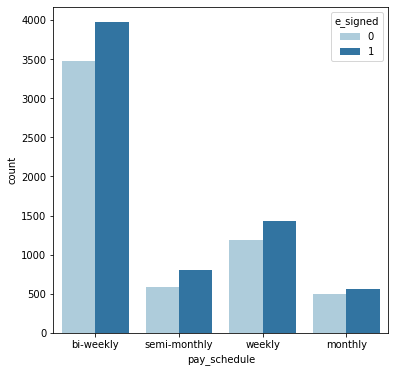

In [ ]:
#plotting the graph of the groupby

plt.figure(figsize=(6,6))
sns.countplot(x='pay_schedule', hue='e_signed', data=train, palette='Paired')

From the chart and output above;  the Bi-weekly payment schedule has the highest number of applicants that have completed the e-signing application process and it also has the highest number of applicants who haven't.

.

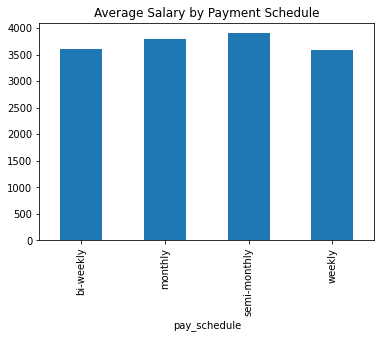

In [ ]:
# Creating a graph that shows the payment schedule by average income earned:

payment_schedule_by_income_avg = train.groupby('pay_schedule')['income'].mean()

pay_schedule_bar = payment_schedule_by_income_avg.plot(kind='bar', title = 'Average Salary by Payment Schedule')

 From the chart above, it can be deduced that averagely; the  highest income earners prefer to pay their loans semi-monthly. The second highest income earners prefer to pay their loans monthly.

-

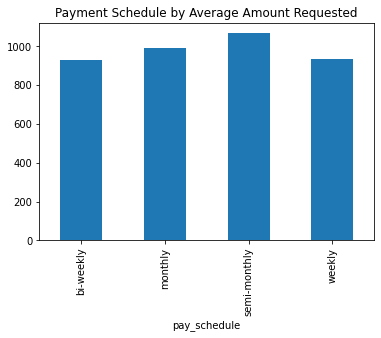

In [ ]:
# Creating a graph that shows the payment schedule by average amount requested:

payment_schedule_by_loan_avg = train.groupby('pay_schedule')['amount_requested'].mean()

payment_schedule_by_loan_avg_bar= payment_schedule_by_loan_avg.plot(kind='bar', title = 'Payment Schedule by Average Amount Requested')

The chart above shows that average, applicants who requested above 1000 as loans prefer the semi-monthly plan. Let's not  forget that the highest income earners also prefer the semi-monthly payment schedule

.

<Figure size 576x432 with 0 Axes>

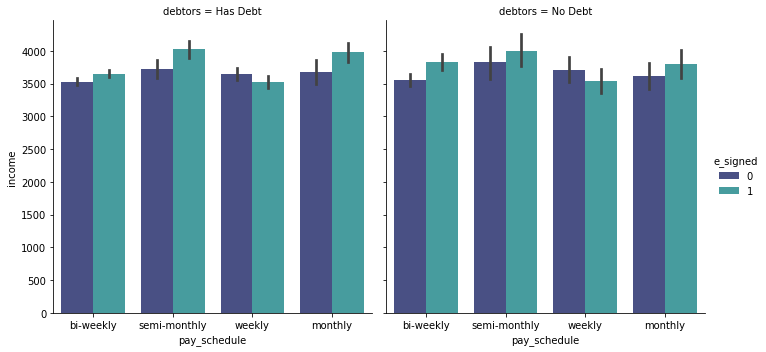

In [ ]:
#checking for users with existing debt based on their income, payment schedule and e signature

plt.figure(figsize=(8,6))
sns.catplot(kind = "bar", x='pay_schedule', y='income', hue = 'e_signed', data=train, palette='mako', col = "debtors")

Both charts above behave very similarly. The income earned by applicants who have completed the application process(e-signed) seems to be higher than those who haven't except in the Weekly Payment Schedule as seen from both charts.

<Figure size 576x432 with 0 Axes>

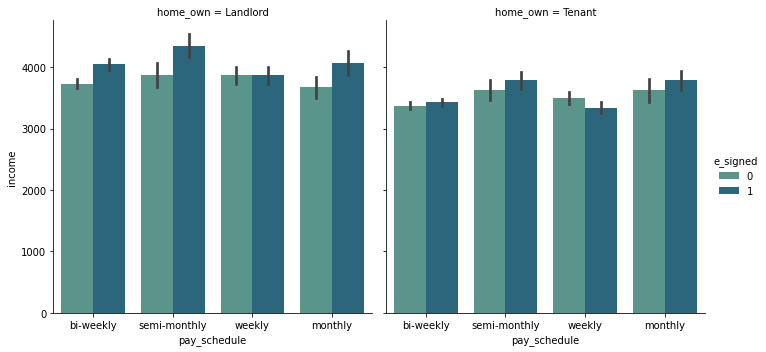

In [ ]:
#checking for users who are home owners based on their income, payment schedule and e signature

plt.figure(figsize=(8,6))
sns.catplot(kind = "bar", x='pay_schedule', y='income', hue = 'e_signed',
            data=train, palette='crest', col = "home_own");

Comparing the Landlord chart to the Tenant chart, we can see that the Landlords generally earn higher income than the Tenants. Also, on the Landlord chart, the income earned by applicants that have completed the e-signature process is equal to the income those applicants who haven't in the Weekly Payment Schedule.

Most applicants who haven't completed the application process(e-signed) earn a lower income than those who have, except in cases like the Weekly Payment Schedule in the Landlord chart and the Weekly Payment Schedule in the Tenant chart.  

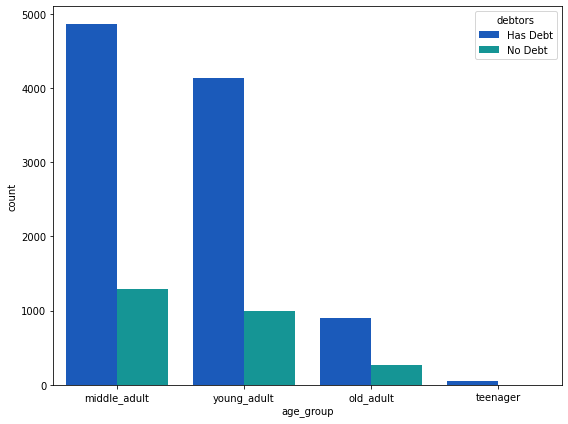

In [ ]:
# Looking at the population distribution of the applicants across different age groups and has_debt:

plt.figure(figsize=(8,6))
sns.countplot(x="age_group", hue="debtors", data=train, palette="winter")
plt.tight_layout()

From the clustured column chart above, it can be seen that middle adult age group has the highest number of loan applicants and a large number of them have debts.In fact, across all the age groups, most of the loan applicants have a higher debt count compared to their non-debt count.

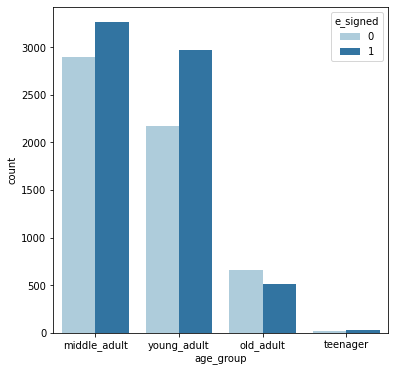

In [ ]:
plt.figure(figsize=(6,6))
sns.countplot(x='age_group', hue='e_signed', data=train, palette='Paired')

Most middle adults, young adults and Teenagers have completed the application process(e-signed). The middle adults have a large number of applicants who are yet complete the application process(e-signed). It can be noticed that the number of old adults who are yet to complete the application process is higher than those who have completed the application process.

.

(array([0, 1, 2, 3]), <a list of 4 Text major ticklabel objects>)

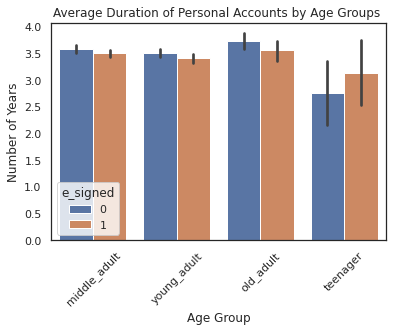

In [ ]:
sns.set(style='white')

#create grouped bar chart
sns.barplot(x='age_group', y='personal_account_y', hue='e_signed', data=train)

#add overall title
plt.title('Average Duration of Personal Accounts by Age Groups ', fontsize=12)

#add axis titles
plt.xlabel('Age Group')
plt.ylabel('Number of Years')

#rotate x-axis labels
plt.xticks(rotation=45)

On an average, the Old Adults have had personal accounts for longer periods(years) than any other age group. Followed by Middle Adults, Young Adults and Teenagers respectively. The population of loan applicants who have completed their application process(e-signed=1) from the Old adults, Young Adults and Middle adults is lesser than the applicants who haven't; Although it doesn't seem to be the case for the Teenagers.

.

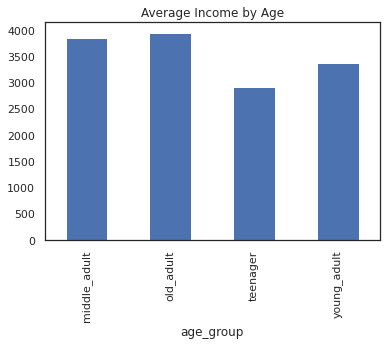

In [ ]:
# Looking at the distribution of the payment schedule across the loan applicants 

age_group_income = train.groupby('age_group')['income'].mean()

age_group_income_bar= age_group_income.plot(kind='bar', title = 'Average Income by Age')

Averagely, the Old Adults(60-99) earn more than other age groups although followed closely by the middle_adults(40-59). The teenagers on average earn the least income

.

[Text(0.5, 1.0, 'Income vs Amount requested correlation')]

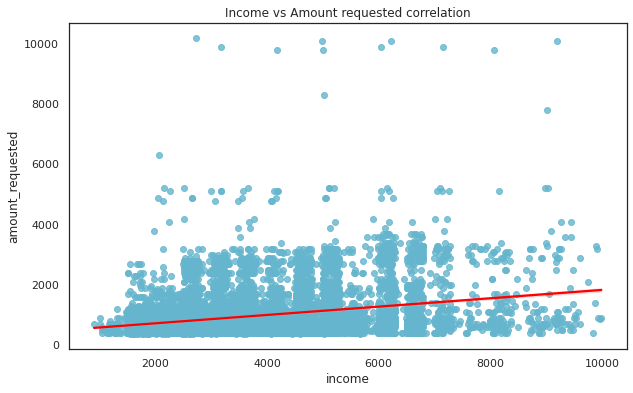

In [ ]:
#checking for correlation between income and amount requested 

plt.figure(figsize=(10,6))
sns.regplot(data = train, y = "amount_requested", x = "income",
           color = "c", line_kws=dict(color='red')).set(title = "Income vs Amount requested correlation")

.

#### Taking a look at the Has_Debt Column

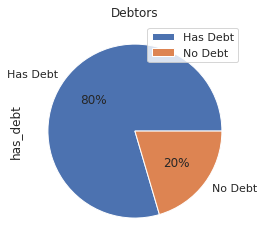

In [ ]:
# Plotting a pie chart that shows the distribution Landlords and the non-home owners among the loan applicants.

train.groupby(['debtors']).count().plot(kind='pie', y='has_debt',autopct='%1.0f%%', title='Debtors')

The pie chart shows that about 80% of the loan applicants are owing money. Who are the debtors?

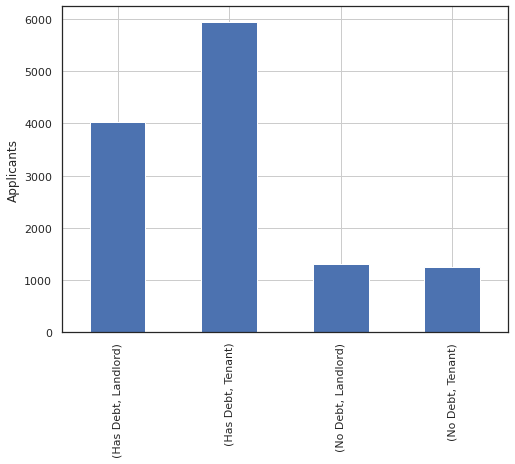

In [ ]:
# Who are the debtors?

home_owners_payment = train.groupby(['debtors', 'home_own'])['Entry_id'].count().plot(kind='bar',figsize=(8,6))
plt.xlabel('')
plt.ylabel('Applicants')
plt.grid()
plt.show()

From the Chart, there are more Tenants owing debts than Landlords. However there is a small difference between the Tenants and Landlords who don't have debt.

#### Have the Debtors completed the e-signing application process?

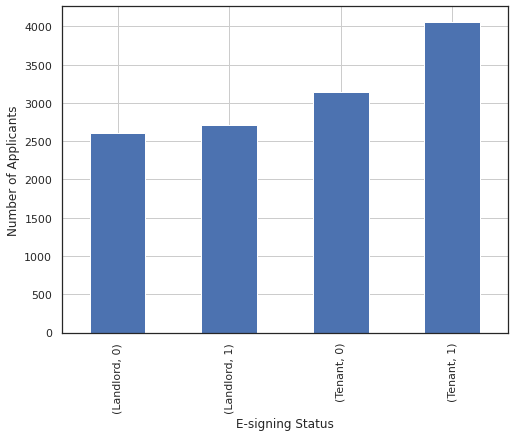

In [ ]:
home_owners_payment = train.groupby(['home_own', 'e_signed'])['Entry_id'].count().plot(kind='bar',figsize=(8,6))
plt.xlabel('E-signing Status')
plt.ylabel('Number of Applicants')
plt.grid()
plt.show()

From the chart above, a large number of Tenants have completed thier e-signing process with a little more than half of the Landlords completing their application process.

### Taking a look at the Inquires made in the Last Month.

In [ ]:
train.groupby(["pay_schedule", "e_signed"])["inquiries_last_month"].sum()

pay_schedule  e_signed
bi-weekly     0           22985
              1           25516
monthly       0            3337
              1            3717
semi-monthly  0            4235
              1            5501
weekly        0            7523
              1            8466
Name: inquiries_last_month, dtype: int64

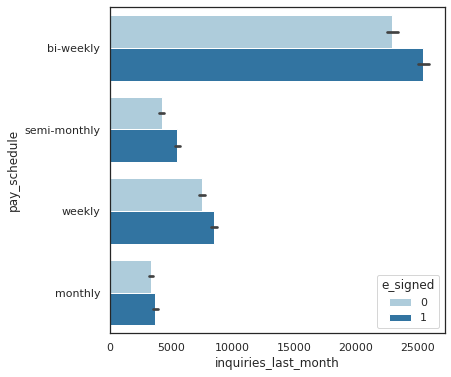

In [ ]:
# Plotting a bar plot to show the total inquiries made in the last month across all payment schedules

plt.figure(figsize=(6,6))
sns.barplot(y='pay_schedule',x='inquiries_last_month', hue='e_signed', data=train,estimator=sum, palette='Paired')

* Loan applicants using the bi-weekly payment scehdule made the most enquires in the last month.
* Loan applicants who have completed the application process(e_signed) made the most enquires in the last month

In [ ]:
train.groupby(["pay_schedule", "e_signed"])["inquiries_last_month"].mean()

pay_schedule  e_signed
bi-weekly     0           6.612486
              1           6.425585
monthly       0           6.782520
              1           6.613879
semi-monthly  0           7.177966
              1           6.893484
weekly        0           6.311242
              1           5.899652
Name: inquiries_last_month, dtype: float64

.

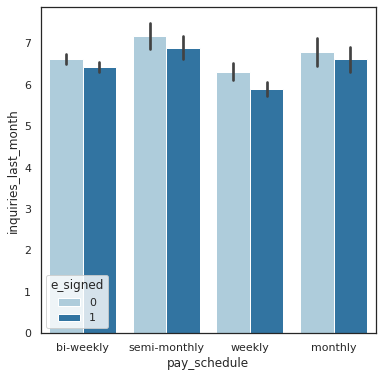

In [ ]:
# Plotting a bar plot to show the average inquiries made in the last month across all payment schedules

plt.figure(figsize=(6,6))

sns.barplot(x='pay_schedule',y='inquiries_last_month', hue='e_signed', data=train,estimator=np.mean, palette='Paired')


                                                                                                                              .

                                .

# Conclusion:

The Data was able to offer insights on the status of the Applicants and their loan application process. Insights derived show that:
* More than 50% of the total loan applicants have completed their application process(e-signed = 1).
* About 80% of the Loan applicants have debts and about 48% of the debtors are Tenants(non-home-owners).
* The middle adults have the highest loan applications and also the highest debtors of all the age group.
* Most Loan applicants who are Landlords prefer the bi-weekly and semi-monthly payment schedule.
* The Bi-weekly payment plan is the most preferred payment plan among Loan applicants. Most of the Loan applicants using the Bi-weekly plan have completed their application process(e-signed).
* On an average; Loan Applicants that have completed their application process(e-signed) requested larger amount of loans than those who haven't. 
* Most applicants who haven't completed the application process(e-signed) earn a lower income than those who have.
* On an average, the Old Adults have had personal accounts for longer periods(years) than any other age group. Followed by Middle Adults, Young Adults and Teenagers respectively.
* The higher the inquiries in the last month, the higher the population of Loan applicants that have completed the application process. 
* About 3.9% of the Loan applicants had been employed for less than a year.
* About 2.2% of the Loan applicants have personal accounts that were less than a year old.
* About 8.2% of the Loan applicants have stayed in their current address for less than a year.
* risk_score_4 is highly correlated with risk_score_5	
* risk_score_5 is highly correlated with risk_score_4	
* ext_quality_score is highly correlated with ext_quality_score_2	
* ext_quality_score_2 is highly correlated with ext_quality_score


##### Upon analyzing , a couple of columns had zero values:
* months_employed has 9229 (73.7%) zeros	
* years_employed has 484  zeros 	
* current_address_year has 1029 zeros 	
* personal_account_m has 184 zeros	
* personal_account_y has 277 zeros 

# Machine Learning Model Building

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import OrdinalEncoder

#### inserting additional data for data augumentation

In [ ]:
url= 'https://www.kaggle.com/datasets/yashpaloswal/esigning-of-loanbased-on-financial-history/download?datasetVersionNumber=1'

Extra data was gotten from the above url to augument the train.csv file given during the competition, the extra data is publicly availabe on kaggle and can be dowloaded via the url

In [ ]:
extra_data= pd.read_csv('Financial-Data.csv')

In [ ]:
train= pd.read_csv('train.csv')
test= pd.read_csv('test.csv')

In [ ]:
# Augumenting the train file with the extra data

data= extra_data.append(train).drop_duplicates(inplace=False).dropna(inplace=False)
data

,Entry_id,age,pay_schedule,home_owner,income,months_employed,years_employed,current_address_year,personal_account_m,personal_account_y,...,amount_requested,risk_score,risk_score_2,risk_score_3,risk_score_4,risk_score_5,ext_quality_score,ext_quality_score_2,inquiries_last_month,e_signed
0,7629673,40,bi-weekly,1,3135,0,3,3,6,2,...,550,36200,0.737398,0.903517,0.487712,0.515977,0.580918,0.380918,10,1
1,3560428,61,weekly,0,3180,0,6,3,2,7,...,600,30150,0.738510,0.881027,0.713423,0.826402,0.730720,0.630720,9,0
2,6934997,23,weekly,0,1540,6,0,0,7,1,...,450,34550,0.642993,0.766554,0.595018,0.762284,0.531712,0.531712,7,0
3,5682812,40,bi-weekly,0,5230,0,6,1,2,7,...,700,42150,0.665224,0.960832,0.767828,0.778831,0.792552,0.592552,8,1
4,5335819,33,semi-monthly,0,3590,0,5,2,2,8,...,1100,53850,0.617361,0.857560,0.613487,0.665523,0.744634,0.744634,12,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17903,9949728,31,monthly,0,3245,0,5,3,2,6,...,700,71700,0.691126,0.928196,0.664112,0.838012,0.727705,0.627705,2,0
17904,9442442,46,bi-weekly,0,6525,0,2,1,3,3,...,800,51800,0.648525,0.970832,0.699241,0.844724,0.774918,0.474918,3,0
17905,9857590,46,weekly,0,2685,0,5,1,1,8,...,1200,59650,0.677975,0.918141,0.687981,0.939101,0.472045,0.672045,9,0
17906,8708471,42,bi-weekly,0,2515,0,3,5,6,1,...,400,80200,0.642741,0.885684,0.456448,0.686823,0.406568,0.406568,3,1


In [ ]:
# converting the pay_schedule column to a numerical variable

encoder=OrdinalEncoder()
encoder.fit(data['pay_schedule'].values.reshape(-1, 1))

data['pay_schedule']=encoder.transform(data['pay_schedule'].values.reshape(-1, 1))
test['pay_schedule']=encoder.transform(test['pay_schedule'].values.reshape(-1, 1))

In [ ]:
# seperating the features and target variable

X= data.drop(['e_signed'], axis=1)
Y= data[['e_signed']]

The final result is an ensemble of random forest and extra trees, so we train random forest first then extra trees

In [ ]:
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier

In [ ]:
model_rf= RandomForestClassifier(random_state=0, n_estimators=200)

In [ ]:
model_rf.fit(X,Y)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  """Entry point for launching an IPython kernel.


RandomForestClassifier(n_estimators=200, random_state=0)

In [ ]:
# since the metric used is AUC, we take the probability of the postivie class

pred_rf= model_rf.predict_proba(test)[:, 1]

In [ ]:
model_et= ExtraTreesClassifier(random_state=0, n_estimators=200)
model_et.fit(X,Y)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


ExtraTreesClassifier(n_estimators=200, random_state=0)

In [ ]:
pred_et= model_et.predict_proba(test)[:, 1]

In [ ]:
result=pd.DataFrame()
result['rf']= pred_rf
result['et']= pred_et
result

,rf,et
0,0.165,0.0
1,0.255,0.0
2,0.835,1.0
3,0.840,1.0
4,0.125,0.0
...,...,...
5387,0.850,1.0
5388,0.865,1.0
5389,0.175,0.0
5390,0.170,0.0


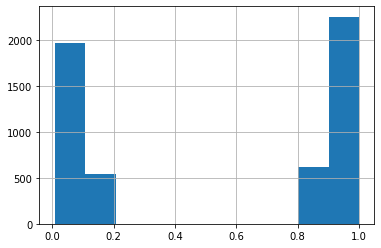

In [ ]:
#taking the median of the predictions and visualize how the classes are seperated

median_result= result.median(axis=1)
median_result.hist()

In [ ]:
#creating the submission file

test['e_signed']=  median_result
name= '1664904120'
test[['Entry_id','e_signed']].to_csv(name, index=False)